# YOLO Export

In [1]:
%run createDerivation.py

import cv2
import os
import numpy as np
import pandas as pd
from ultralytics import YOLO

INPUT_FOLDER = "./sub/paralells/steps/convertedtemp/" 

# 2. Set the path where the processed images will be saved.
OUTPUT_FOLDER = "processed_images" 

# 3. Define the target object classes the script should look for.
TARGET_CLASSES = ['banana', 'apple', 'avocado'] 

# 4. Define the final output size for the images.
FINAL_SIZE = (720, 720) 

# 5. Choose the model. 'yolov8n.pt' is small and fast, perfect for this.
MODEL_NAME = 'yolo11x-seg.pt' 

all_df = pd.read_csv("./sub/paralells/result.csv")

def keep_all(path): return True

# Build a YOLO-based preprocessing + filtering pipeline using create_dataset_variation

# Choose base dataset to (re)process
target_df = all_df

# Ensure required globals exist
assert 'MODEL_NAME' in globals(), "MODEL_NAME not defined (from earlier YOLO cell)."
assert 'FINAL_SIZE' in globals(), "FINAL_SIZE not defined (from earlier YOLO cell)."
assert 'TARGET_CLASSES' in globals(), "TARGET_CLASSES not defined (from earlier YOLO cell)."
assert 'create_dataset_variation' in globals(), "create_dataset_variation not available."

print(f"Loading YOLO model: {MODEL_NAME} ...")
try:
    _yolo_model = YOLO(MODEL_NAME)
except Exception as e:
    raise RuntimeError(f"Failed to load YOLO model '{MODEL_NAME}': {e}")

_target_classes = set(TARGET_CLASSES)

def _best_square_crop_from_results(image, results, names):
    img_h, img_w = image.shape[:2]
    best_detection = None
    highest_conf = -1.0

    for result in results:
        if result.boxes is None:
            continue
        for box in result.boxes:
            class_id = int(box.cls[0])
            class_name = names.get(class_id, str(class_id))
            if class_name not in _target_classes:
                continue
            conf = float(box.conf[0])
            if conf > highest_conf:
                highest_conf = conf
                x1, y1, x2, y2 = box.xyxy[0].cpu().numpy().tolist()
                best_detection = (x1, y1, x2, y2)

    if best_detection is None:
        return None

    x1, y1, x2, y2 = best_detection
    cx = int((x1 + x2) / 2)
    cy = int((y1 + y2) / 2)
    dist_to_top = cy
    dist_to_bottom = img_h - cy
    dist_to_left = cx
    dist_to_right = img_w - cx
    half_size = int(min(dist_to_top, dist_to_bottom, dist_to_left, dist_to_right))
    if half_size <= 0:
        return None
    return (
        max(0, cx - half_size),
        max(0, cy - half_size),
        min(img_w, cx + half_size),
        min(img_h, cy + half_size),
    )

print("PHASE 1: YOLO Detection and Crop Region Precomputation")
# Precompute crop regions for all valid images in base_df
print(f"Scanning {len(target_df)} images for target objects: {sorted(_target_classes)}")
_crop_index = {}
_skipped = 0
_debug_counts = {} # Map: class_name -> set of file_paths

for i, row in target_df.iterrows():
    p = row["file_path"]
    if not isinstance(p, str) or not os.path.isfile(p):
        _skipped += 1
        continue
    img = cv2.imread(p)
    if img is None:
        _skipped += 1
        continue
    try:
        results = _yolo_model(img, verbose=False)
        crop_box = _best_square_crop_from_results(img, results, _yolo_model.names)
        if crop_box is not None:
            _crop_index[p] = crop_box
        else:
            # Debugging: Check what was detected if not the target
            for result in results:
                if result.boxes is None: continue
                for box in result.boxes:
                    c_id = int(box.cls[0])
                    c_name = _yolo_model.names.get(c_id, str(c_id))
                    
                    if c_name not in _target_classes:
                        if c_name not in _debug_counts:
                            _debug_counts[c_name] = set()
                        
                        # Only show up to 3 images per detection type
                        if len(_debug_counts[c_name]) < 3:
                            # If we haven't seen this image for this class yet, print it
                            if p not in _debug_counts[c_name]:
                                x1, y1, x2, y2 = box.xyxy[0].cpu().numpy().tolist()
                                area = (x2 - x1) * (y2 - y1)
                                print(f"DEBUG [Missed Target]: File={os.path.basename(p)} | Detected='{c_name}' | Area={area:.0f} | Box=[{x1:.0f}, {y1:.0f}, {x2:.0f}, {y2:.0f}]")
                                _debug_counts[c_name].add(p)
    except Exception:
        _skipped += 1

print(f"Found {len(_crop_index)} images with target detections. Skipped: {_skipped}")

def yolo_filter_fn(path: str) -> bool:
    return path in _crop_index

def yolo_filter_fn(path: str) -> bool:
    return path in _crop_index

def yolo_crop_map_fn(path: str) -> bytes:
    img = cv2.imread(path)
    if img is None:
        raise ValueError(f"Could not read image: {path}")
    x1, y1, x2, y2 = _crop_index.get(path, (0, 0, img.shape[1], img.shape[0]))
    cropped = img[y1:y2, x1:x2]
    if cropped.size == 0:
        cropped = img  # fallback to original if something went wrong
    resized = cv2.resize(cropped, FINAL_SIZE, interpolation=cv2.INTER_AREA)
    ok, buf = cv2.imencode(".png", resized)
    if not ok:
        raise RuntimeError("Failed to encode cropped image.")
    return buf.tobytes()

variation_tag = f"yolo_crop_{MODEL_NAME}_to_{FINAL_SIZE[0]}x{FINAL_SIZE[1]}"
step1_path = create_dataset_variation(target_df, yolo_filter_fn, yolo_crop_map_fn, variation_tag=variation_tag)
print("New variation CSV:", step1_path)
f = open("step1.txt", "w")
f.write(step1_path)
f.close()



Loading YOLO model: yolo11x-seg.pt ...
PHASE 1: YOLO Detection and Crop Region Precomputation
Scanning 5431 images for target objects: ['apple', 'avocado', 'banana']
DEBUG [Missed Target]: File=32314433801c5e0a3798f3dae05b4be6.png | Detected='orange' | Area=133357 | Box=[924, 499, 1280, 874]
DEBUG [Missed Target]: File=6a3924d688c7b68254e8fd088026d152.png | Detected='person' | Area=195645 | Box=[2317, 2002, 2657, 2578]
DEBUG [Missed Target]: File=6a3924d688c7b68254e8fd088026d152.png | Detected='bird' | Area=354935 | Box=[2916, 1839, 3409, 2558]
DEBUG [Missed Target]: File=385db994447ff874997225004c7473b6.png | Detected='carrot' | Area=867502 | Box=[5599, 0, 6469, 998]
DEBUG [Missed Target]: File=385db994447ff874997225004c7473b6.png | Detected='bowl' | Area=2695922 | Box=[0, 3180, 2153, 4432]
DEBUG [Missed Target]: File=385db994447ff874997225004c7473b6.png | Detected='book' | Area=10478371 | Box=[5, 0, 3218, 3261]
DEBUG [Missed Target]: File=6f17e73b0f1fd3d7c711bcc336bfe0c8.png | Detect

Scanning for incorrect detections...

=== Incorrect Detections: 'bear' (5 images) ===


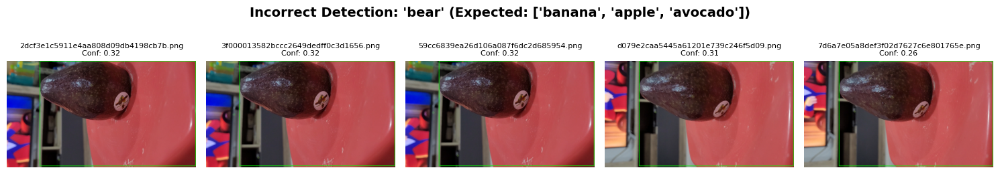


=== Incorrect Detections: 'bed' (20 images) ===


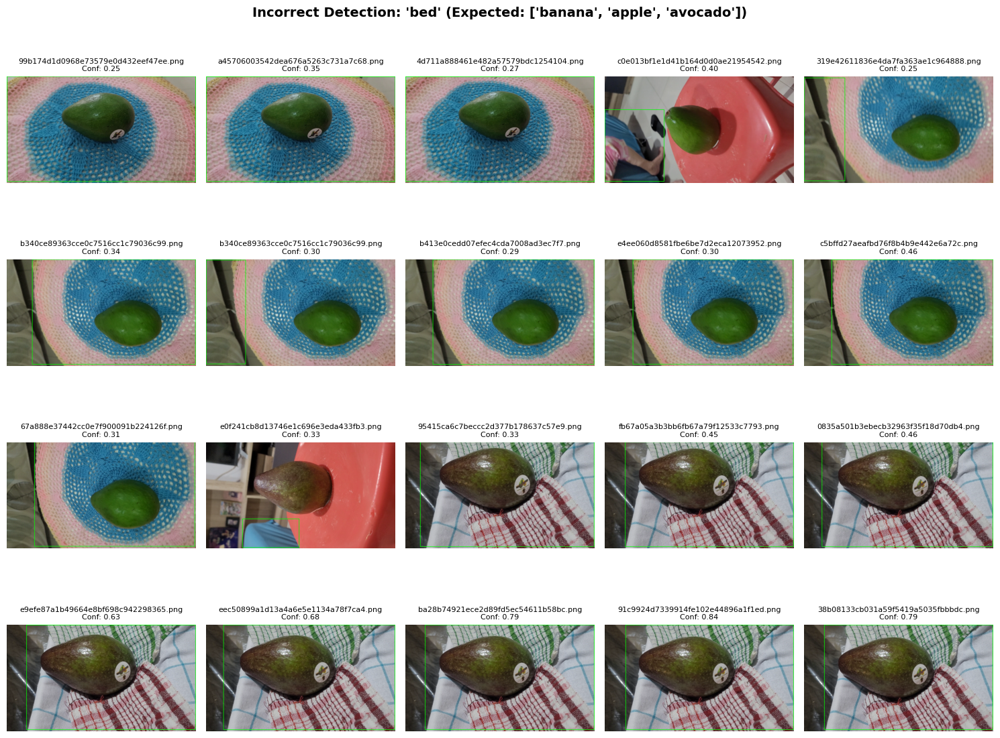


=== Incorrect Detections: 'bird' (8 images) ===


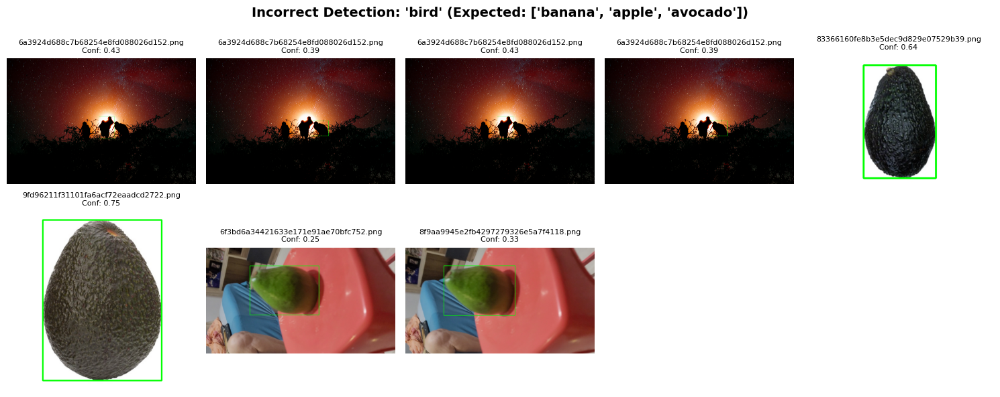


=== Incorrect Detections: 'book' (9 images) ===


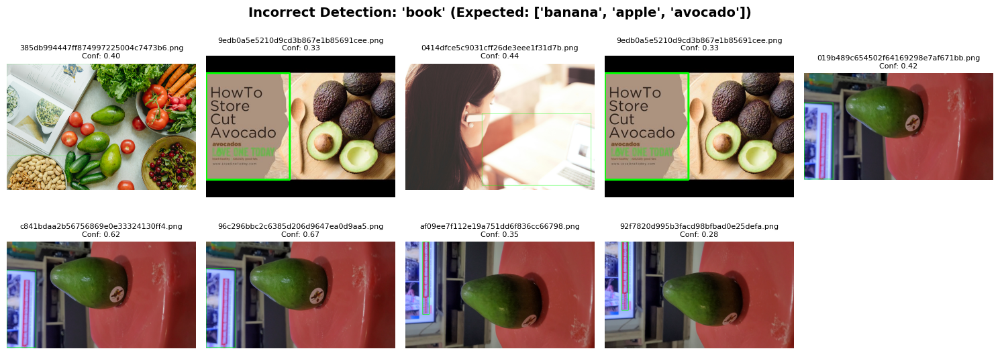


=== Incorrect Detections: 'bottle' (9 images) ===


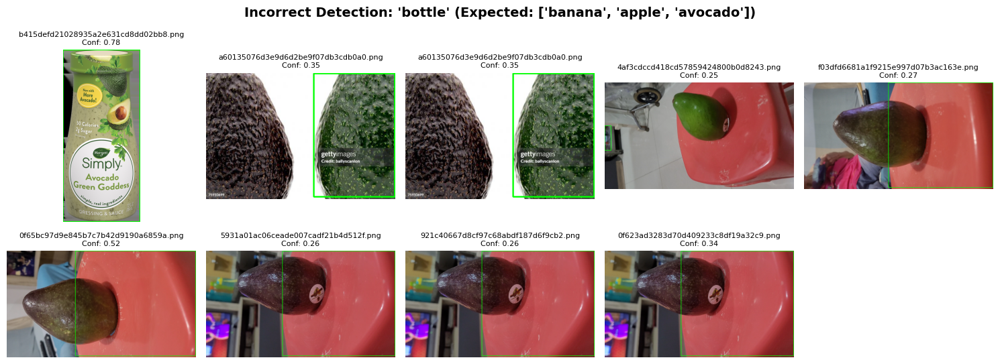


=== Incorrect Detections: 'bowl' (20 images) ===


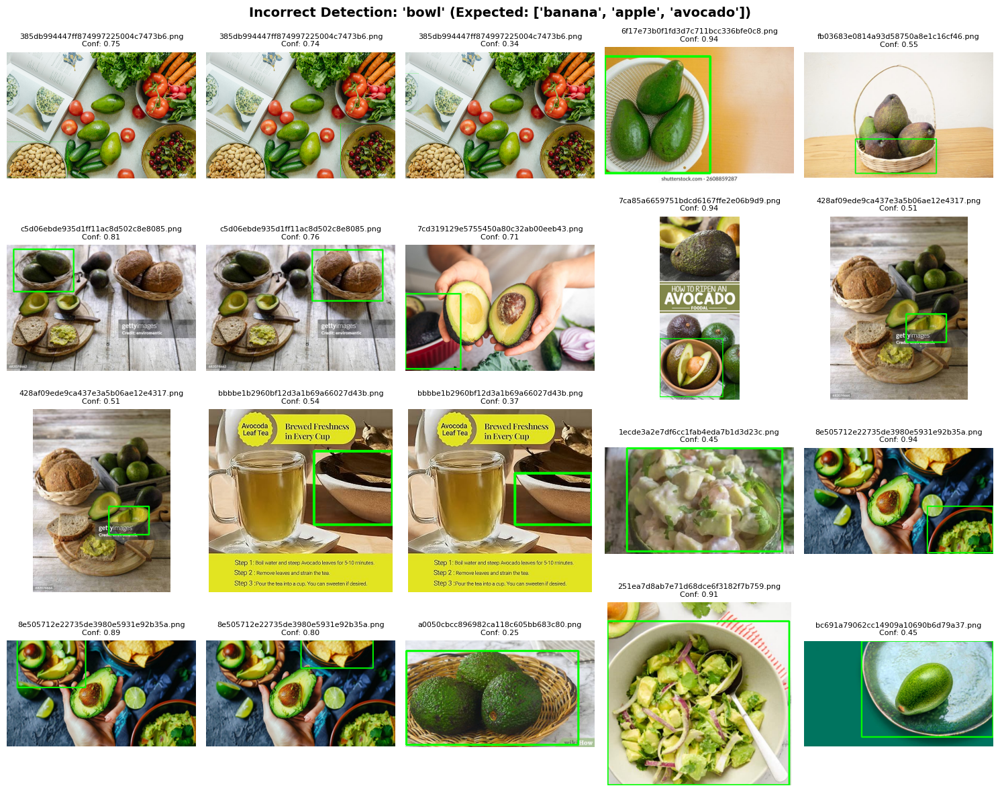


=== Incorrect Detections: 'broccoli' (11 images) ===


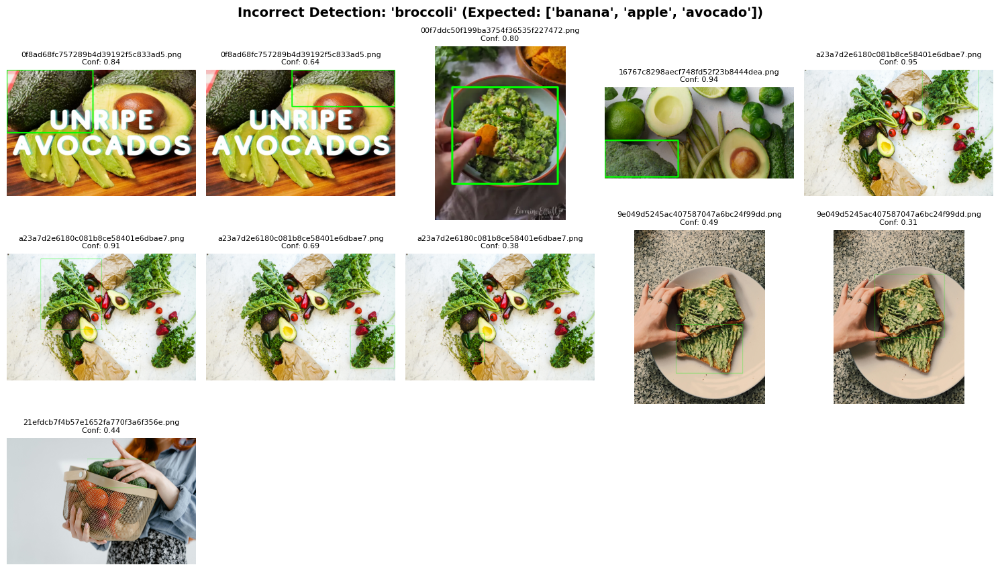


=== Incorrect Detections: 'cake' (20 images) ===


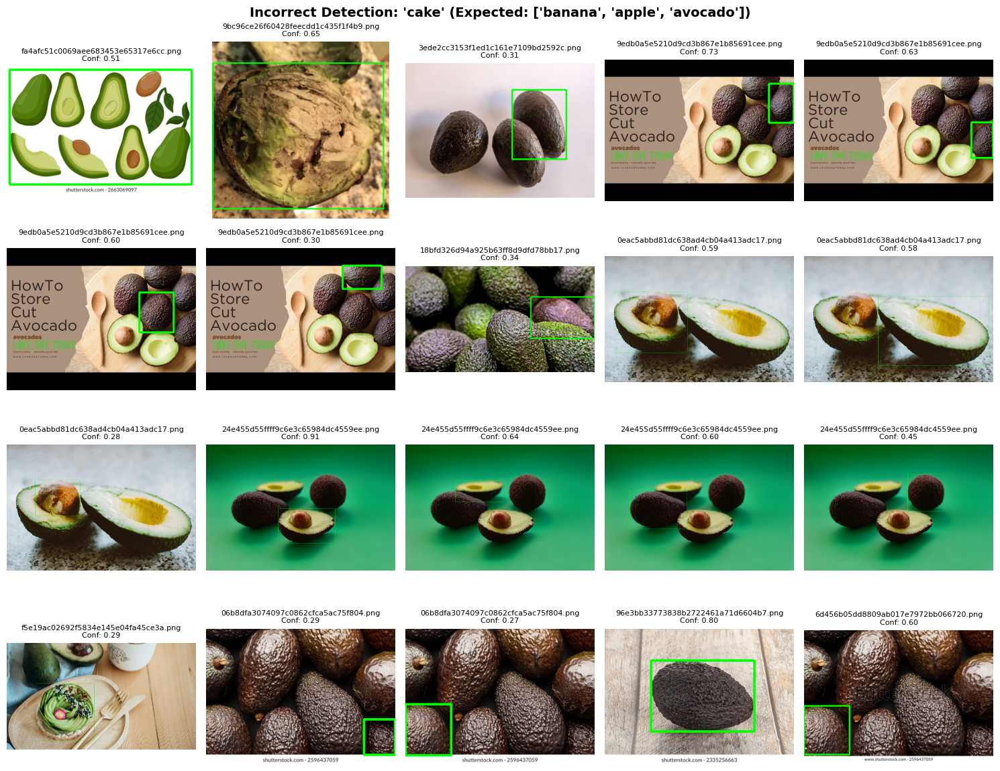


=== Incorrect Detections: 'car' (5 images) ===


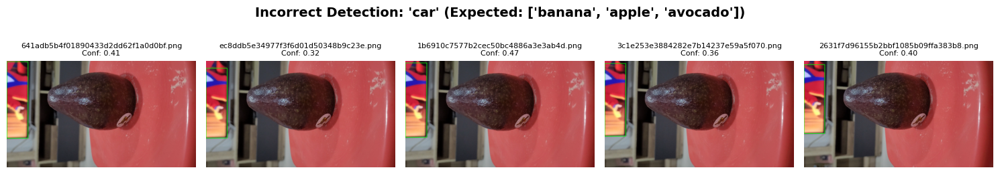


=== Incorrect Detections: 'carrot' (19 images) ===


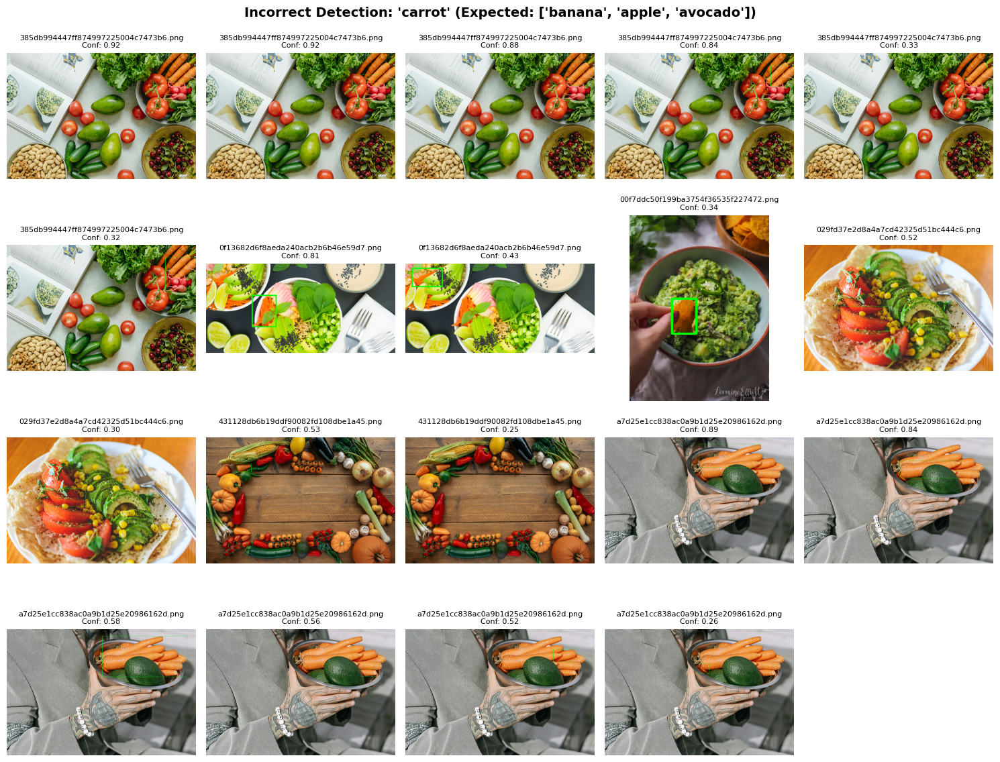


=== Incorrect Detections: 'cat' (1 images) ===


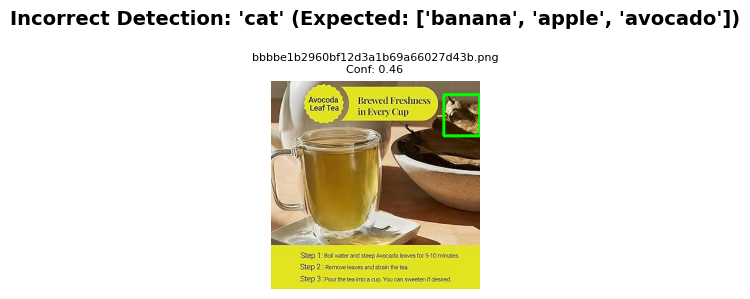


=== Incorrect Detections: 'chair' (2 images) ===


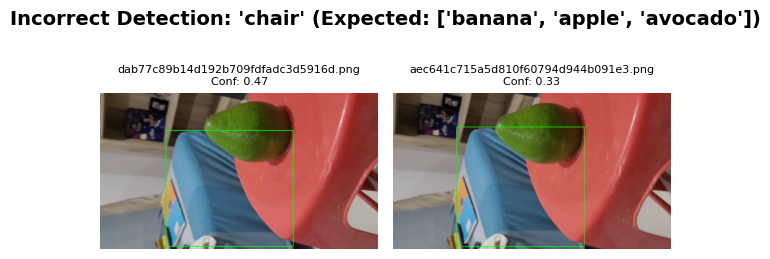


=== Incorrect Detections: 'couch' (3 images) ===


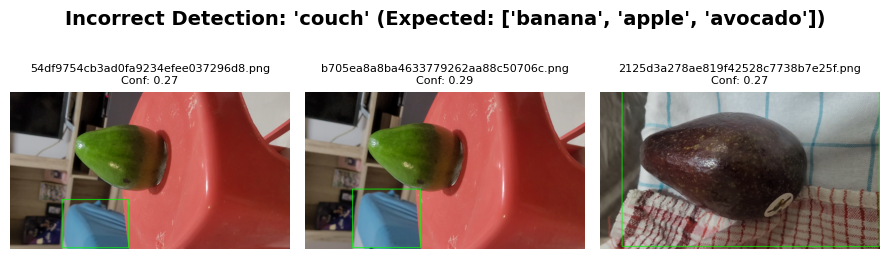


=== Incorrect Detections: 'cup' (14 images) ===


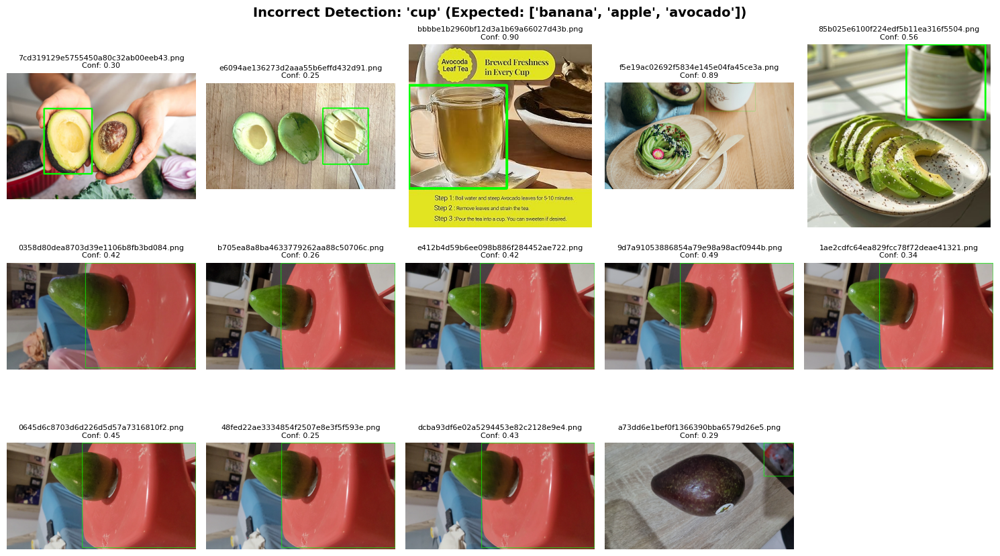


=== Incorrect Detections: 'dining table' (20 images) ===


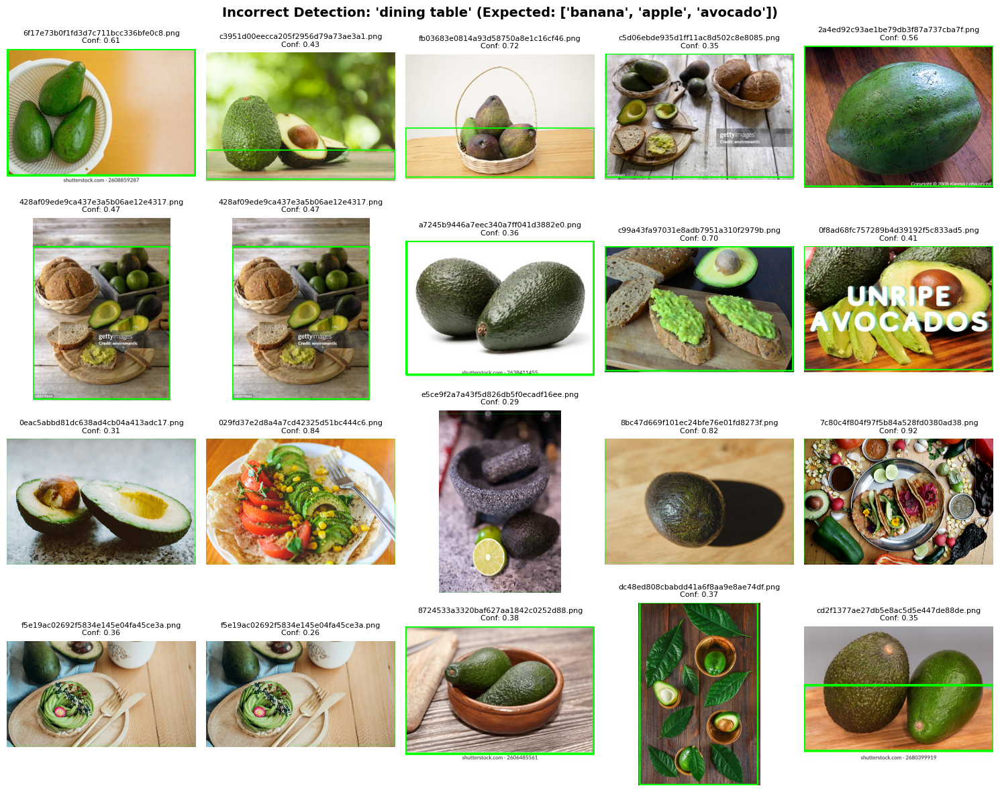


=== Incorrect Detections: 'donut' (20 images) ===


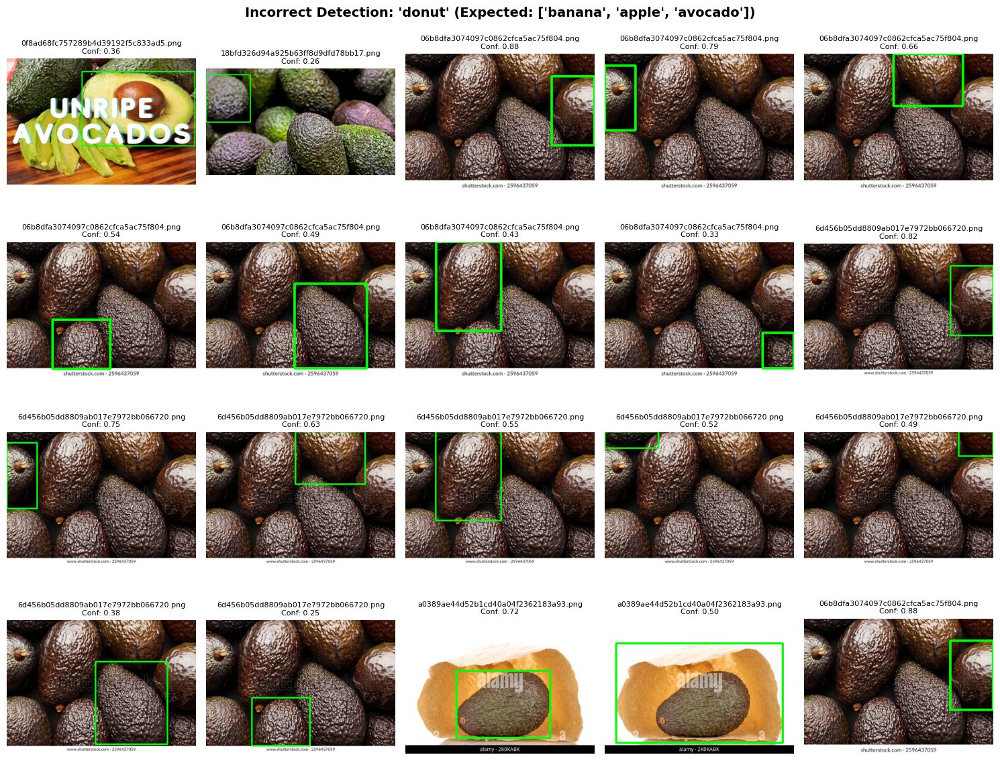


=== Incorrect Detections: 'fire hydrant' (20 images) ===


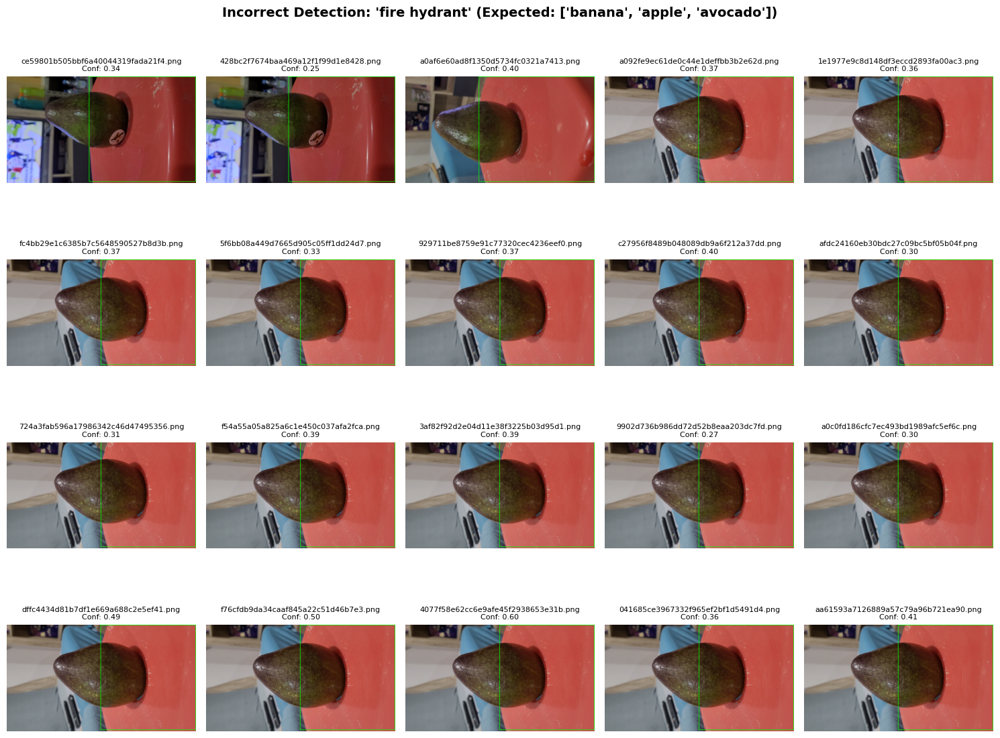


=== Incorrect Detections: 'fork' (4 images) ===


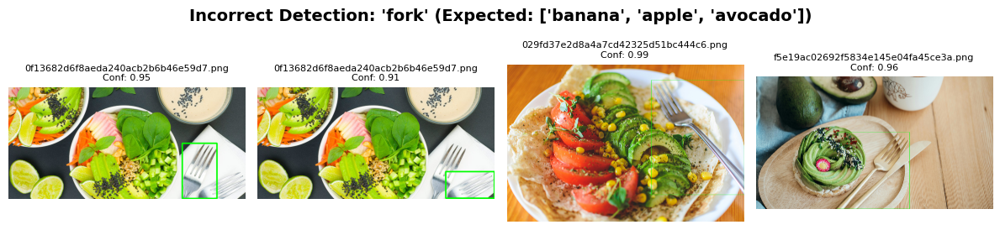


=== Incorrect Detections: 'frisbee' (20 images) ===


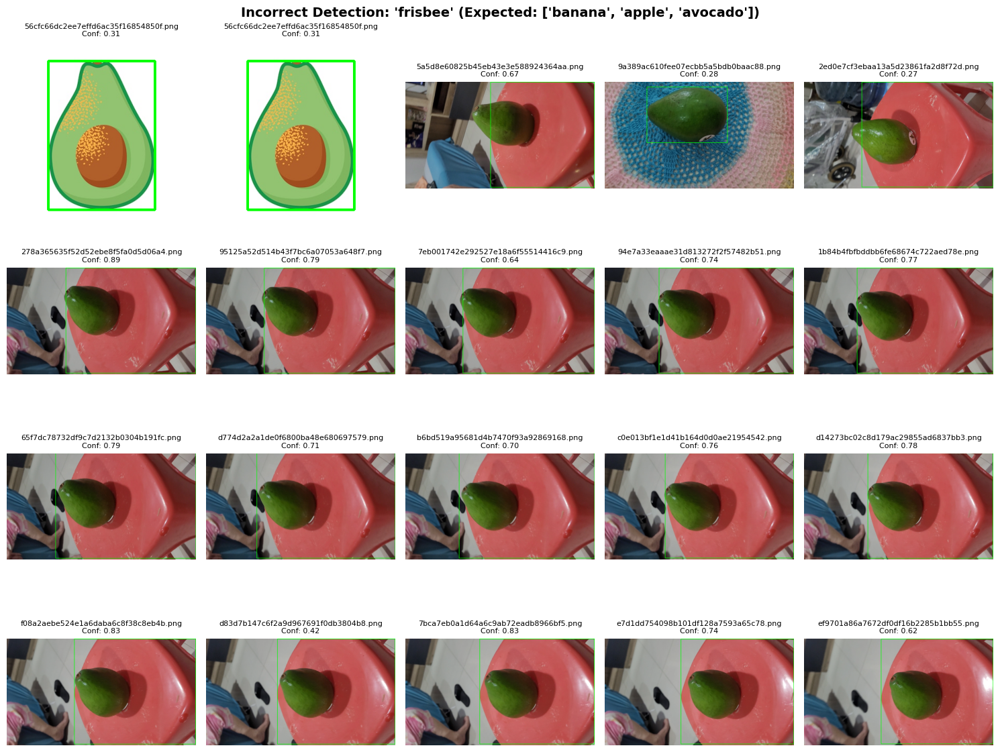


=== Incorrect Detections: 'handbag' (1 images) ===


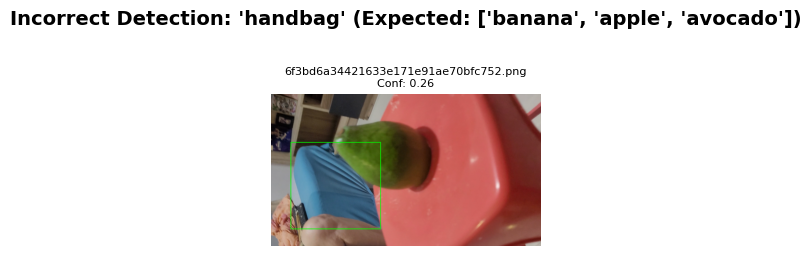


=== Incorrect Detections: 'hot dog' (3 images) ===


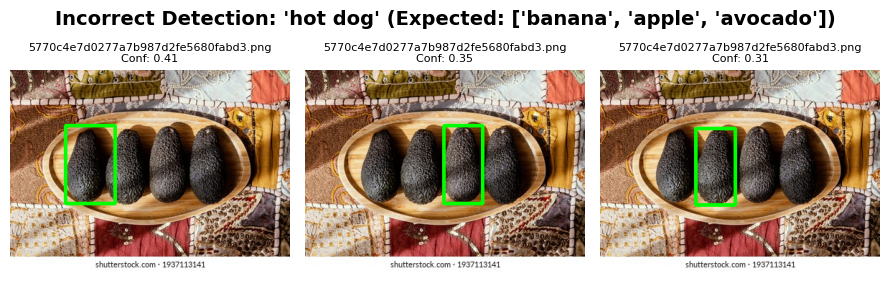


=== Incorrect Detections: 'keyboard' (1 images) ===


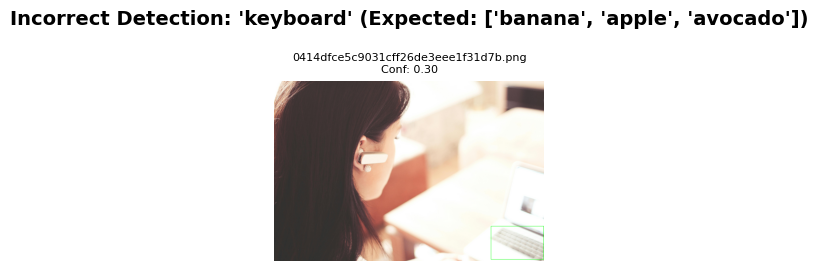


=== Incorrect Detections: 'knife' (19 images) ===


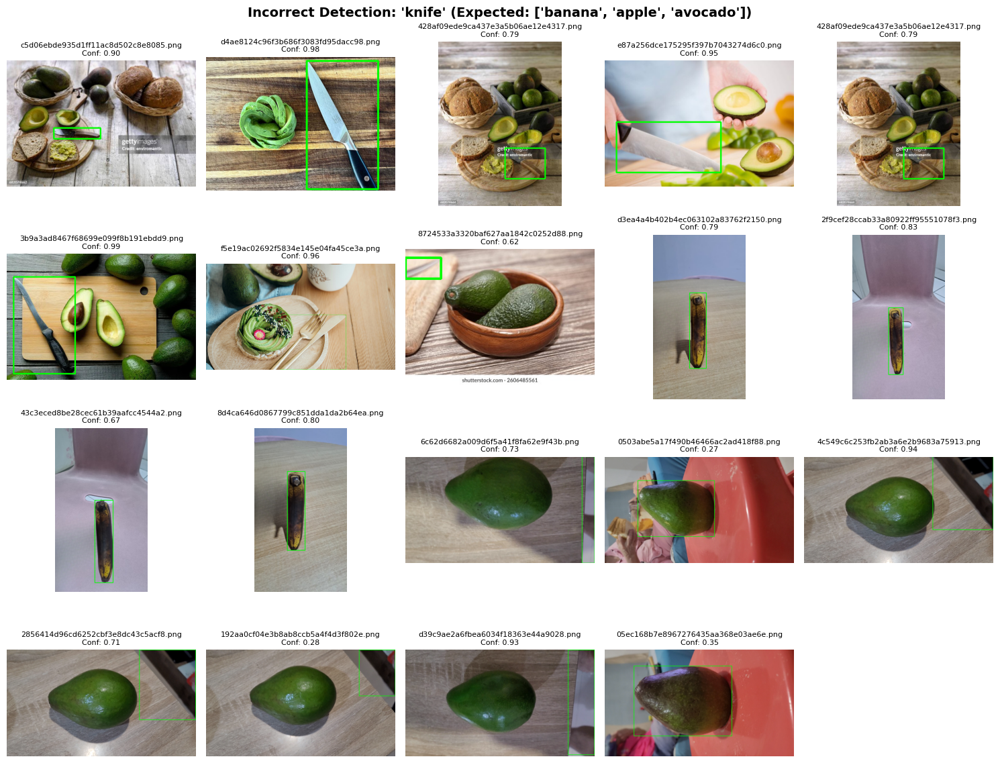


=== Incorrect Detections: 'laptop' (1 images) ===


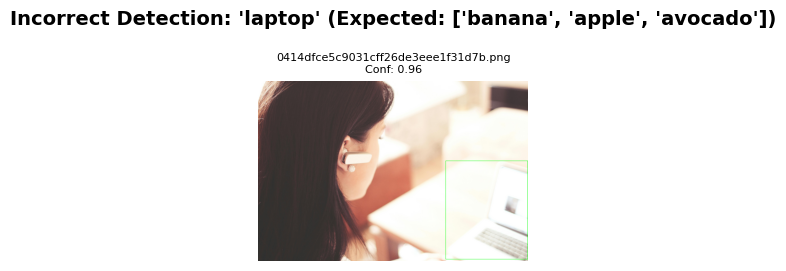


=== Incorrect Detections: 'mouse' (18 images) ===


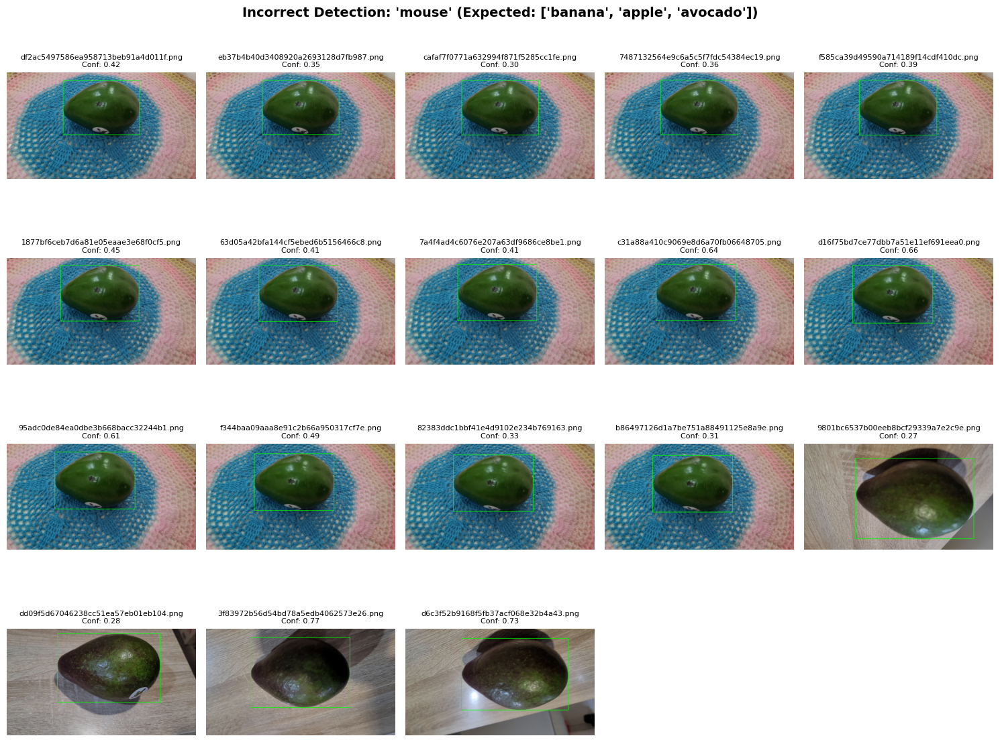


=== Incorrect Detections: 'orange' (20 images) ===


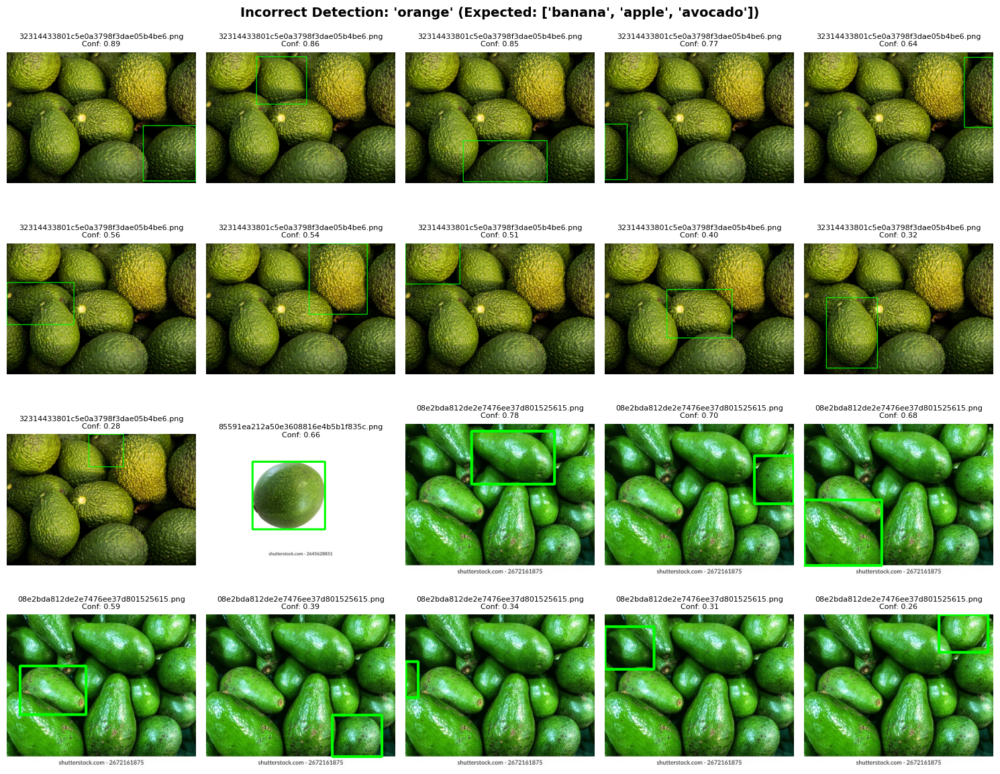


=== Incorrect Detections: 'person' (20 images) ===


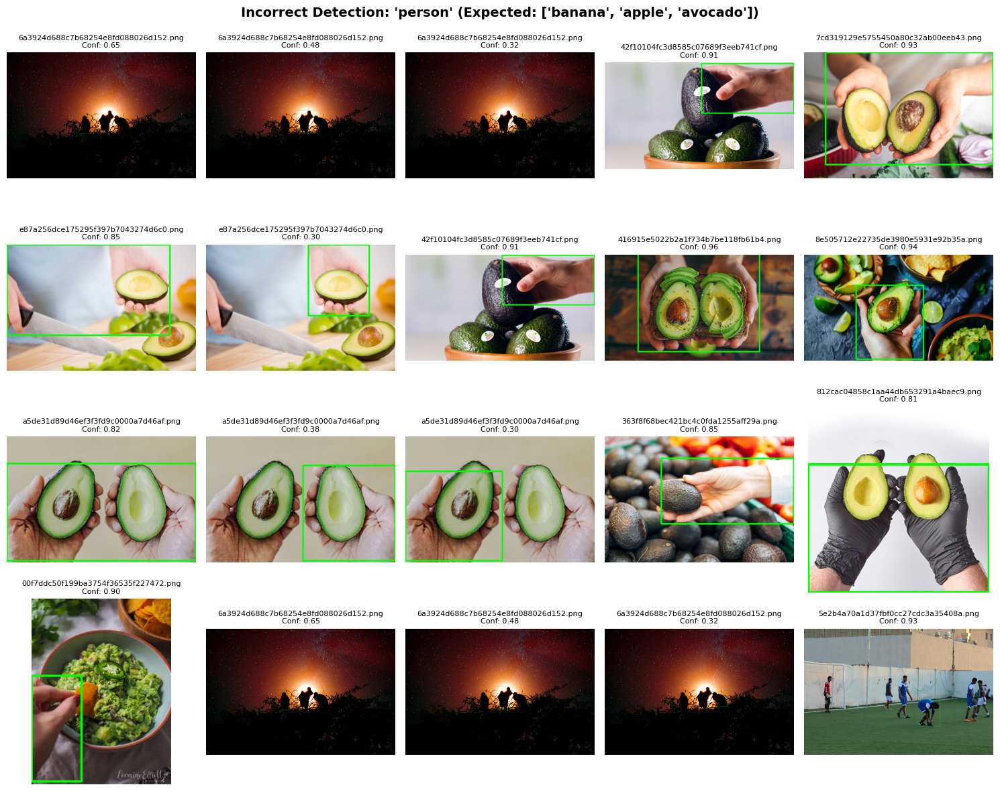


=== Incorrect Detections: 'pizza' (3 images) ===


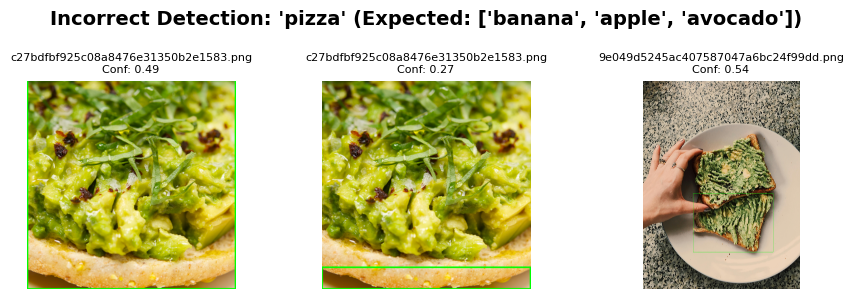


=== Incorrect Detections: 'potted plant' (2 images) ===


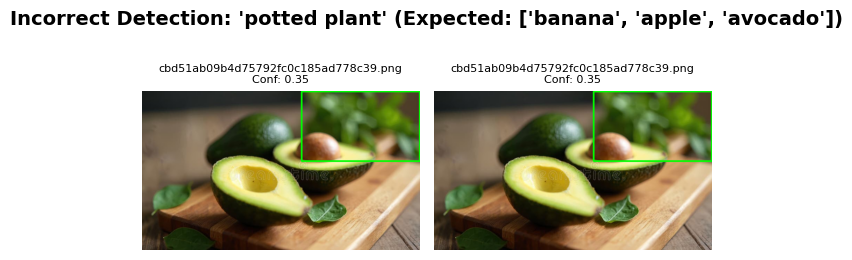


=== Incorrect Detections: 'sandwich' (20 images) ===


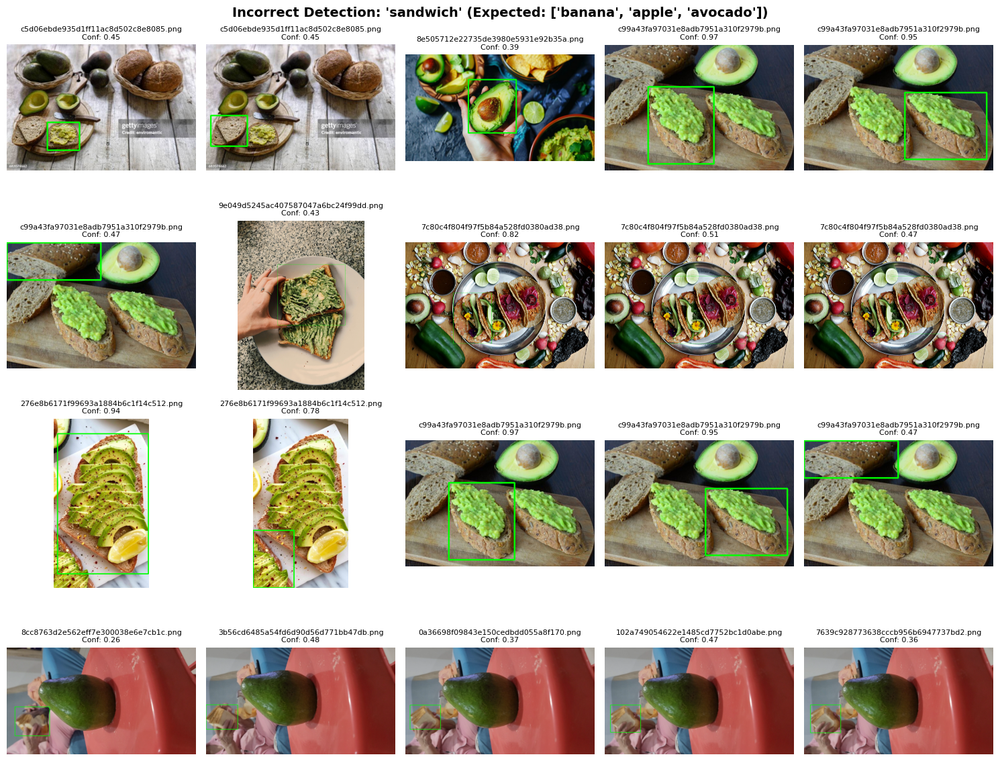


=== Incorrect Detections: 'scissors' (1 images) ===


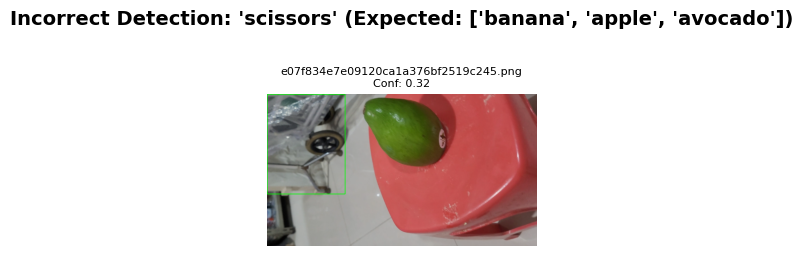


=== Incorrect Detections: 'sink' (15 images) ===


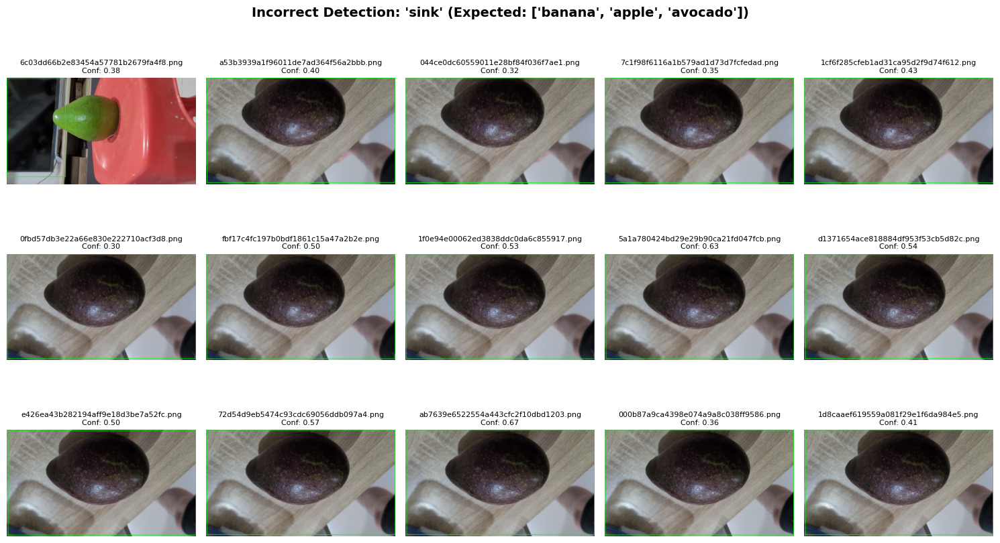


=== Incorrect Detections: 'spoon' (5 images) ===


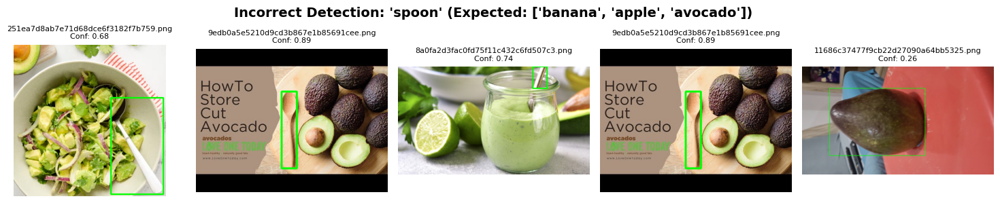


=== Incorrect Detections: 'sports ball' (6 images) ===


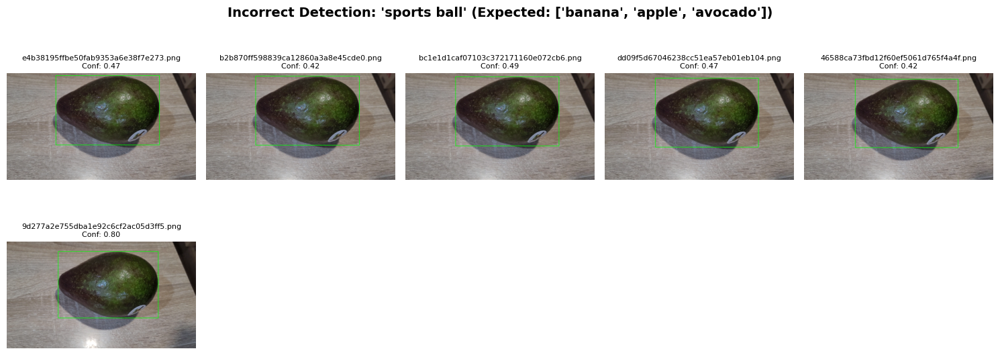


=== Incorrect Detections: 'stop sign' (2 images) ===


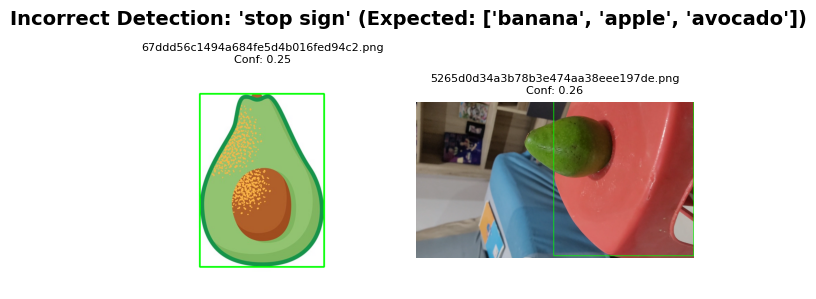


=== Incorrect Detections: 'suitcase' (4 images) ===


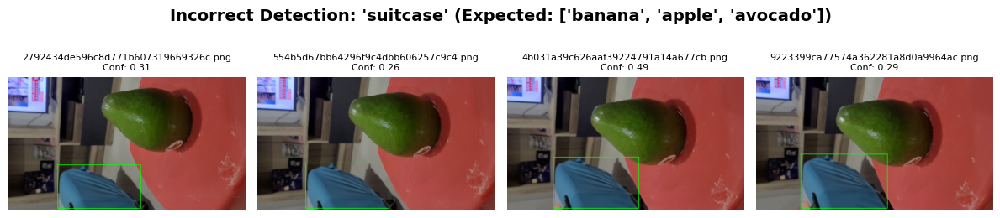


=== Incorrect Detections: 'toilet' (10 images) ===


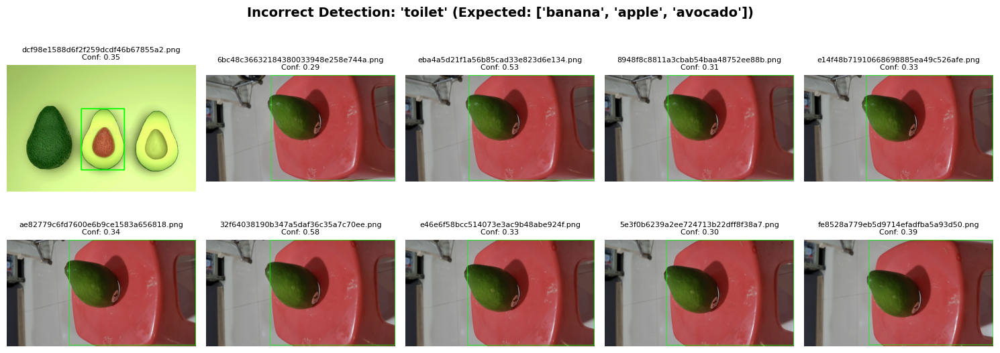


=== Incorrect Detections: 'traffic light' (20 images) ===


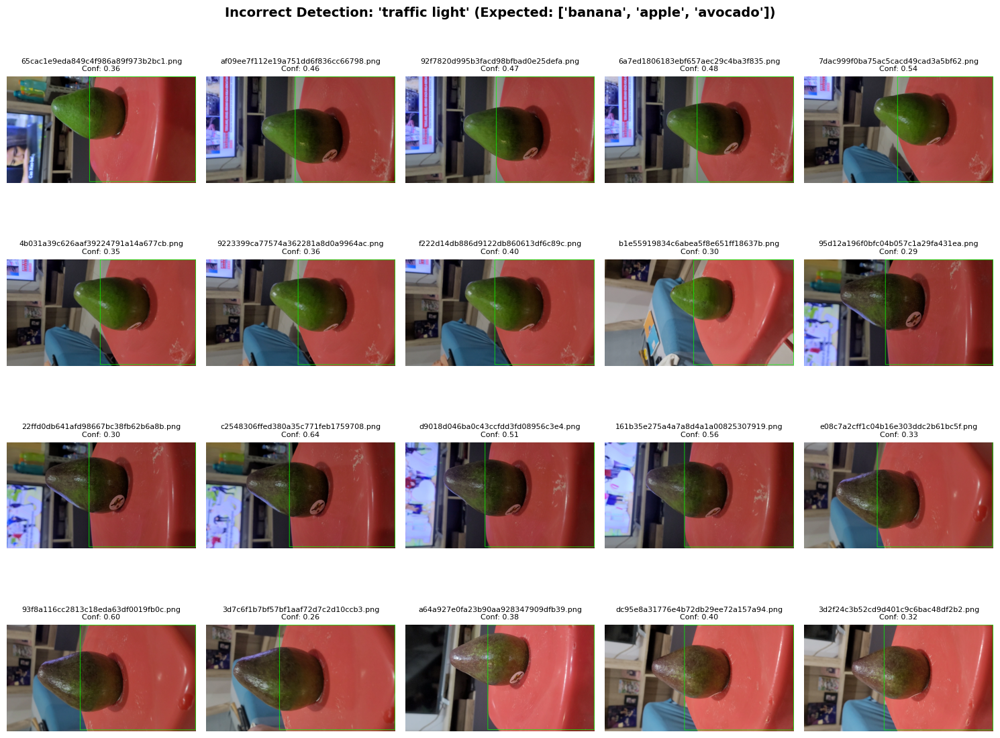


=== Incorrect Detections: 'tv' (20 images) ===


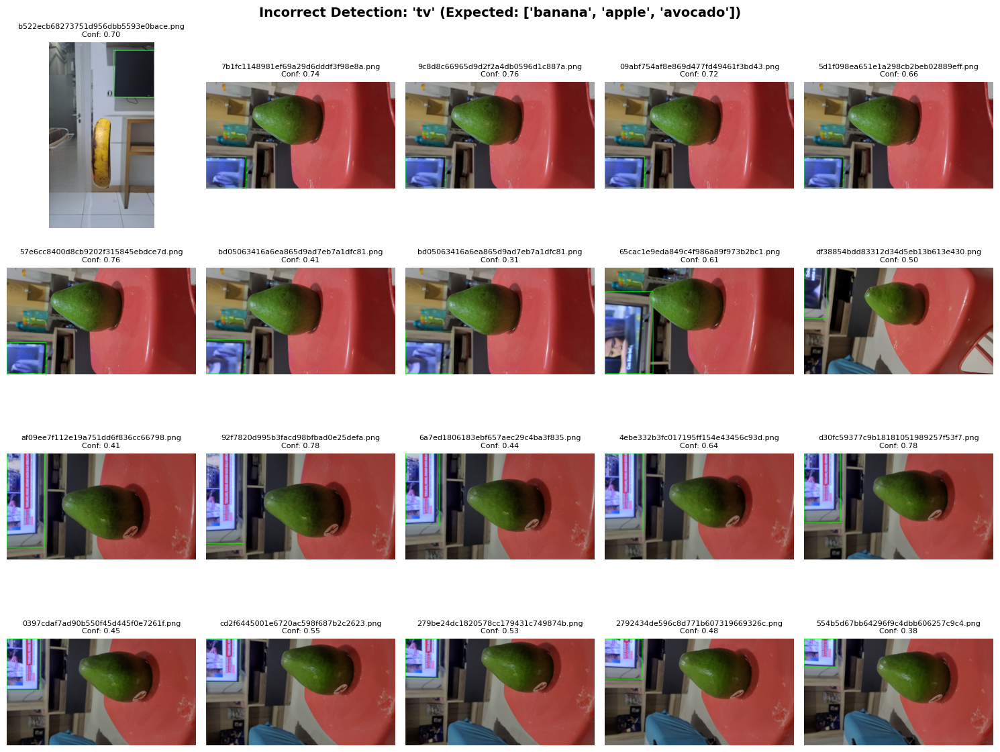


=== Incorrect Detections: 'umbrella' (1 images) ===


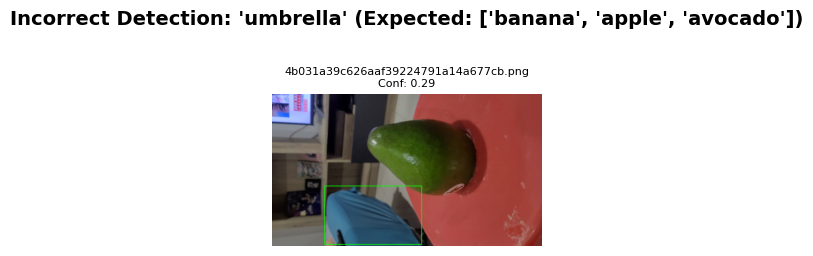


=== Incorrect Detections: 'vase' (20 images) ===


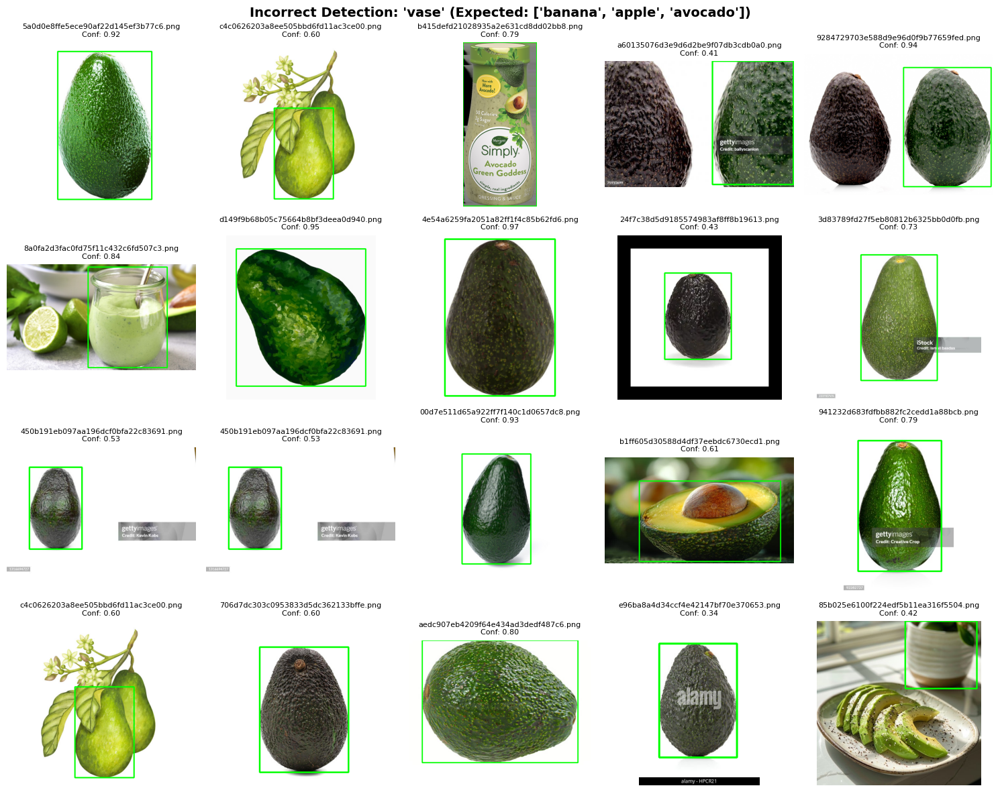


Summary: Found 41 different incorrect detection classes


In [2]:
from matplotlib.gridspec import GridSpec

import matplotlib.pyplot as plt

# Collect incorrect detections (non-target classes) with their details
incorrect_detections = {}

print("Scanning for incorrect detections...")
for i, row in target_df.iterrows():
    p = row["file_path"]
    if not isinstance(p, str) or not os.path.isfile(p):
        continue
    
    img = cv2.imread(p)
    if img is None:
        continue
    
    try:
        results = _yolo_model(img, verbose=False)
        
        # Check if this image has no target detection
        has_target = p in _crop_index
        
        if not has_target:
            # Collect what was detected instead
            for result in results:
                if result.boxes is None:
                    continue
                for box in result.boxes:
                    c_id = int(box.cls[0])
                    c_name = _yolo_model.names.get(c_id, str(c_id))
                    
                    if c_name not in _target_classes:
                        if c_name not in incorrect_detections:
                            incorrect_detections[c_name] = []
                        
                        if len(incorrect_detections[c_name]) < 20:
                            conf = float(box.conf[0])
                            x1, y1, x2, y2 = box.xyxy[0].cpu().numpy().tolist()
                            incorrect_detections[c_name].append({
                                'path': p,
                                'box': (int(x1), int(y1), int(x2), int(y2)),
                                'conf': conf,
                                'img': img
                            })
    except Exception as e:
        continue

# Display grid for each incorrect class
for class_name, detections in sorted(incorrect_detections.items()):
    num_images = len(detections)
    if num_images == 0:
        continue
    
    print(f"\n=== Incorrect Detections: '{class_name}' ({num_images} images) ===")
    
    # Create grid layout
    cols = min(5, num_images)
    rows = (num_images + cols - 1) // cols
    
    fig = plt.figure(figsize=(cols * 3, rows * 3))
    fig.suptitle(f"Incorrect Detection: '{class_name}' (Expected: {TARGET_CLASSES})", fontsize=14, fontweight='bold')
    
    for idx, det in enumerate(detections):
        ax = fig.add_subplot(rows, cols, idx + 1)
        
        # Draw bounding box on image
        img_display = det['img'].copy()
        x1, y1, x2, y2 = det['box']
        cv2.rectangle(img_display, (x1, y1), (x2, y2), (0, 255, 0), 3)
        
        # Convert BGR to RGB for matplotlib
        img_display = cv2.cvtColor(img_display, cv2.COLOR_BGR2RGB)
        
        ax.imshow(img_display)
        ax.set_title(f"{os.path.basename(det['path'])}\nConf: {det['conf']:.2f}", fontsize=8)
        ax.axis('off')
    
    plt.tight_layout()
    plt.show()

print(f"\nSummary: Found {len(incorrect_detections)} different incorrect detection classes")